In [8]:
import pandas as pd
from pprint import pprint
import numpy as np
# from gspread_pandas import Spread,Client
# from oauth2client.service_account import ServiceAccountCredentials
import gspread 
import json
import geopandas as gpd
import folium


In [3]:
metabolic_colors_20 = ['#a63246' ,'#e56e61' ,'#ea9243' ,'#ffc840' ,'#789b40' ,'#bdd576','#f6e67f' ,'#2db77f' ,'#61c6c0' ,'#61cbe8' ,'#d87fae' ,'#9772a3' ,'#1f6585' ,'#b6517f' ,'#a89778' ,'#eae4b1' ,'#a2a9ad' ,'#a65b4a' ,'#82766a' ,'#797c82']
metabolic_colors_40 = ['#a63246' ,'#cd3e49' ,'#e56e61' ,'#d16d29' ,'#ea9243' ,'#d8a83b' ,'#ffc840' ,'#5f8943' ,'#789b40' ,'#87bf65' ,'#bdd576' ,'#e2e26a' ,'#f6e67f' ,'#288e5b' ,'#2db77f' ,'#43a89a' ,'#61c6c0' ,'#a9dde3' ,'#61cbe8' ,'#60adcd' ,'#d87fae' ,'#a4a9d5' ,'#9772a3' ,'#775285' ,'#1f6585' ,'#2e839e' ,'#b6517f' ,'#a09256' ,'#a89778' ,'#c4b36a' ,'#eae4b1' ,'#f5f3ea' ,'#a2a9ad' ,'#b7744f' ,'#a65b4a' ,'#7b5d52' ,'#82766a' ,'#8c9380' ,'#797c82']


In [ ]:
# tree_data = [
#         {
#                 'value':'Raw Materials ',
#                 'title':'Raw Materials (category_1)',
#                 'children':[
#                         {
#                                 'value':'Bought in Liquid',
#                                 'title':'Bought in Liquid (category_2)',
#                                 'children':[
#                                         {'value':'leaf1','title':'leaf1 (category_3)'},
#                                         {'value':'leaf2','title':'leaf2'},
#                                         {'value':'leaf3','title':'leaf3'}
#                                 ]
#                         }
#                 ]
#         },
#         {
#                 'value':'Raw Materials & Liquids',
#                 'title':'Raw Materials & Liquids',
#                 'children':[
#                         {
#                                 'value':'category_2_item1',
#                                 'title':'category_2_item1_title',
#                                 'children':[
#                                         {'value':'leaf3','title':'leaf3'},
#                                         {'value':'leaf4','title':'leaf4'}
#                                 ]
#                         }
#                 ]  
#         }
# ]

## Diageo pressure data

In [3]:
pressure_url = 'https://docs.google.com/spreadsheets/d/1TPyl6dFr1rSBDuAHksywHxUJIUIaup94wIB2CJMh2xQ/edit#gid=890331805'
sheet_name = 'Long_data_with_pressures'

In [23]:
def sheet_url_split(s_in):
    sheet_id = s_in.split('https://docs.google.com/spreadsheets/d/')[1].split('/')[0]
    return sheet_id

def read_sheet(sheet_id,sheet_name):
    sheet_name = sheet_name.replace(' ','%20')
    url_df = f"https://docs.google.com/spreadsheets/d/{sheet_id}/gviz/tq?tqx=out:csv&sheet={sheet_name}"
    df = pd.read_csv(url_df,header=None)
    return df


In [24]:
sheet_id = sheet_url_split(pressure_url)
pressure = read_sheet(sheet_id,sheet_name)

ParserError: Error tokenizing data. C error: Expected 184 fields in line 9, saw 2408


In [4]:
SHEET_ID = '1TPyl6dFr1rSBDuAHksywHxUJIUIaup94wIB2CJMh2xQ'
SHEET_NAME = 'Long_data_with_pressures'

In [5]:

cred_path = './credentials.json'
with open(cred_path) as j_f:
    cred = json.load(j_f)
gc, authorized_user = gspread.oauth_from_dict(cred)



Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=762501948731-qhnmehe77totps2emnn82m7o7l9r7e7e.apps.googleusercontent.com&redirect_uri=http%3A%2F%2Flocalhost%3A55587%2F&scope=https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fspreadsheets+https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive&state=n4DpkSG6TsO27bJublV9mTNDH4wZ3C&access_type=offline


In [6]:
sh = gc.open("Phase1_pressures")  # spreadsheet name
worksheet = sh.get_worksheet_by_id(890331805) # #gid sheet_id
data = worksheet.get_all_values()
df = pd.DataFrame(data)
df.columns = df.iloc[0] 
df = df[1:] 
df.head()

,level_0,index,Category_L1,Category_L2,Category_L3,Category_L4,Category_L4_includefeed,Category_L0,Material_Group,Material,...,Traced?,Converted crop weight (tonnes),unique_id_x,Global Warming Potential (kg CO2-Eq),Air Pollution (kg PM2.5-Eq),Land Use (m2),Water Pollution (kg P eq),Land Transformation (m2),Soil Pollution (kg SO2 eq),Water Use (m3)
1,0,0,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,,Raw materials,MOLASSES (112L),3301000424,...,0,63100.24,"Sugar cane, at farm/GT Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
2,1,1,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,,Raw materials,MOLASSES (112L),3301000424,...,0,63100.24,"Sugar cane, at farm/DO Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
3,2,2,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053000,...,0,3343.504373,"Sugar cane, at farm/GT Economic",297577.1195,192.3397533,581164.4231,170.2895258,140947.2595,575.1526481,24018.19736
4,3,3,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053900,...,0,1203.90385,"Sugar cane, at farm/GT Economic",107149.3259,69.2562484,209261.3044,61.31656872,50751.22668,207.0966298,8648.291446
5,4,4,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053400,...,0,188.6794805,"Sugar cane, at farm/GT Economic",16792.76892,10.85405032,32796.0694,9.609719528,7953.886923,32.45681499,1355.386593


In [7]:
df.head()

,level_0,index,Category_L1,Category_L2,Category_L3,Category_L4,Category_L4_includefeed,Category_L0,Material_Group,Material,...,Traced?,Converted crop weight (tonnes),unique_id_x,Global Warming Potential (kg CO2-Eq),Air Pollution (kg PM2.5-Eq),Land Use (m2),Water Pollution (kg P eq),Land Transformation (m2),Soil Pollution (kg SO2 eq),Water Use (m3)
1,0,0,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,,Raw materials,MOLASSES (112L),3301000424,...,0,63100.24,"Sugar cane, at farm/GT Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
2,1,1,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,,Raw materials,MOLASSES (112L),3301000424,...,0,63100.24,"Sugar cane, at farm/DO Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
3,2,2,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053000,...,0,3343.504373,"Sugar cane, at farm/GT Economic",297577.1195,192.3397533,581164.4231,170.2895258,140947.2595,575.1526481,24018.19736
4,3,3,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053900,...,0,1203.90385,"Sugar cane, at farm/GT Economic",107149.3259,69.2562484,209261.3044,61.31656872,50751.22668,207.0966298,8648.291446
5,4,4,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,,Bought in liquids,RAW RUM (143),3100053400,...,0,188.6794805,"Sugar cane, at farm/GT Economic",16792.76892,10.85405032,32796.0694,9.609719528,7953.886923,32.45681499,1355.386593


In [8]:
pressure = df.copy()

In [9]:
print(pressure['Category_L1'].value_counts(),'\n')
print(pressure['Category_L2'].value_counts(),'\n')
print(pressure['Category_L3'].value_counts(),'\n')
print(pressure['Category_L4'].value_counts(),'\n')

Raw Materials              3263
Raw Materials & Liquids       7
Name: Category_L1, dtype: int64 

Raw Materials & Liquid    2661
Bought in Liquid           602
Ingredients                  7
Name: Category_L2, dtype: int64 

Flavours & Botanicals             942
Other - Raw Materials & Liquid    835
Cereals                           520
Neutral Spirit                    452
Sugar & Sweeteners                361
Matured Rum                        88
Whisky                             46
Vodka                              13
Dairy                               9
Cachaça                             3
N/A                                 1
Name: Category_L3, dtype: int64 

Flavours                           856
Grapes & Wine                      722
Sugar & Sweeteners/Undefined       276
GNS                                231
Malt                               231
Grain (GNS)                        183
Hops                               120
Agave                               97
Matured Rum

In [10]:
cate_cols = ['Category_L1', 'Category_L2', 'Category_L3', 'Category_L4']

def build_tree(df, current_level, max_level, path='', new_df=None):
    if current_level == 0:
        # Initialize the new DataFrame with the same index as the original
        new_df = pd.DataFrame(index=df.index)
    
    if current_level >= max_level:
        return [], new_df

    next_level = current_level + 1
    tree = []

    category_col = f'Category_L{current_level + 1}'
    title_col = f'{category_col}_Title'

    for index, item in enumerate(df[cate_cols[current_level]].unique()):
        if pd.notna(item):
            # Create a path label with leading numbers
            new_path = f'{path}{index:02d}_'

            # Filter the DataFrame for the current category item
            filtered_df = df[df[cate_cols[current_level]] == item]
            
            # Recursive call to build children and update new DataFrame
            children, new_df = build_tree(filtered_df, next_level, max_level, new_path, new_df)

            # Add category and title information to the new DataFrame
            new_df.loc[filtered_df.index, category_col] = item
            new_df.loc[filtered_df.index, title_col] = f'{new_path}{item} ({cate_cols[current_level]})'

            node = {
                'value': f'{new_path}{item} ({cate_cols[current_level]})',
                'title': item,
                'children': children
            }
            if not node['children']:
                del node['children']
            tree.append(node)

    return tree, new_df

In [11]:
tree_data, new_df = build_tree(pressure, 0, len(cate_cols))

In [12]:
print(new_df.shape,pressure.shape)

(3270, 8) (3270, 46)


In [13]:
tree_data_df = new_df.loc[:,['Category_L4_Title','Category_L3_Title','Category_L2_Title','Category_L1_Title']]
tree_data_df.head()

,Category_L4_Title,Category_L3_Title,Category_L2_Title,Category_L1_Title
1,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1)
2,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1)
3,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1)
4,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1)
5,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1)


In [15]:
pressure_new = pd.concat([tree_data_df,pressure],axis=1)
pressure_new.head()

,Category_L4_Title,Category_L3_Title,Category_L2_Title,Category_L1_Title,level_0,index,Category_L1,Category_L2,Category_L3,Category_L4,...,Traced?,Converted crop weight (tonnes),unique_id_x,Global Warming Potential (kg CO2-Eq),Air Pollution (kg PM2.5-Eq),Land Use (m2),Water Pollution (kg P eq),Land Transformation (m2),Soil Pollution (kg SO2 eq),Water Use (m3)
1,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1),0,0,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,...,0,63100.24,"Sugar cane, at farm/GT Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
2,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1),1,1,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,...,0,63100.24,"Sugar cane, at farm/DO Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
3,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),2,2,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,3343.504373,"Sugar cane, at farm/GT Economic",297577.1195,192.3397533,581164.4231,170.2895258,140947.2595,575.1526481,24018.19736
4,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),3,3,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,1203.90385,"Sugar cane, at farm/GT Economic",107149.3259,69.2562484,209261.3044,61.31656872,50751.22668,207.0966298,8648.291446
5,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),4,4,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,188.6794805,"Sugar cane, at farm/GT Economic",16792.76892,10.85405032,32796.0694,9.609719528,7953.886923,32.45681499,1355.386593


In [16]:
pressure_new.columns


Index(['Category_L4_Title', 'Category_L3_Title', 'Category_L2_Title',
       'Category_L1_Title', 'level_0', 'index', 'Category_L1', 'Category_L2',
       'Category_L3', 'Category_L4', 'Category_L4_includefeed', 'Category_L0',
       'Material_Group', 'Material', 'Material_Description', 'Text',
       'Vendor_Country', 'Vendor_Name', 'Vendor_Code', 'Vendor_City',
       'Vendor_Latitude', 'Vendor_Longitude', 'Plant_Country', 'Plant_Code',
       'Plant_Name', 'Base_Unit_of_Measure', 'Converted_units', 'Fiscal_Year',
       'Quantity', 'Product_weight_in_tonnes', 'Municipality',
       'Conversion_name', 'Conversion_factor', 'Economic_allocation',
       'Category_L4_LCA', 'LCA_match', 'LCA_match_animal_husbandry',
       'Locally_sourced_update', 'Fabio_source_commodity', 'Harvest_Country',
       'Traced?', 'Converted crop weight (tonnes)', 'unique_id_x',
       'Global Warming Potential (kg CO2-Eq)', 'Air Pollution (kg PM2.5-Eq)',
       'Land Use (m2)', 'Water Pollution (kg P eq)',


In [45]:
cate_cols = ['Category_L1','Category_L2','Category_L3','Category_L4']
index_cols = ['Converted crop weight (tonnes)', 
              'Global Warming Potential (kg CO2-Eq)', 'Air Pollution (kg PM2.5-Eq)',
              'Land Use (m2)', 'Water Pollution (kg P eq)',
              'Land Transformation (m2)', 'Soil Pollution (kg SO2 eq)',
              'Water Use (m3)']
final_col = f'{cate_cols[-1]}_Title'

In [46]:
final_col

'Category_L4_Title'

In [18]:
value = ["00_00_00_00_Molasses (Category_L4)",
 "00_00_00_01_Sugar & Sweeteners/Undefined (Category_L4)",
"00_00_00_02_Sugar (Category_L4)",
"00_00_01_00_Sorghum (Category_L4)",
"00_00_01_01_Barley (Category_L4)",
"00_00_01_02_Malt (Category_L4)",
"00_00_01_03_Maize (Category_L4)",
"00_00_01_04_Wheat (Category_L4)",
"00_00_01_05_Rye (Category_L4)",
"00_00_01_06_Hops (Category_L4)",
"00_00_02_00_Grapes & Wine (Category_L4)"
]

In [48]:
test = pressure_new.loc[pressure_new[final_col].isin(value),:]
test1 = test.groupby([final_col]).sum() 
test1_ra = test1.div(test1.sum(axis=0),axis=1).reset_index() 

TypeError: unsupported operand type(s) for /: 'str' and 'str'

In [57]:
for i in index_cols:
    test[i] = pd.to_numeric(test[i], errors='coerce')

/var/folders/hk/rh9qxbnn6tng7j9hj450183m0000gn/T/ipykernel_31664/3536552351.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test[i] = pd.to_numeric(test[i], errors='coerce')


In [58]:
test1 = test.groupby([final_col]).sum() 
test1.head()

/var/folders/hk/rh9qxbnn6tng7j9hj450183m0000gn/T/ipykernel_31664/291943983.py:1: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  test1 = test.groupby([final_col]).sum()


,Converted crop weight (tonnes),Global Warming Potential (kg CO2-Eq),Air Pollution (kg PM2.5-Eq),Land Use (m2),Water Pollution (kg P eq),Land Transformation (m2),Soil Pollution (kg SO2 eq),Water Use (m3)
Category_L4_Title,,,,,,,,
00_00_00_00_Molasses (Category_L4),162113.328084,1.400563e+07,9716.297472,2.809312e+07,9449.416225,5.320684e+06,30060.962813,1.444757e+06
00_00_00_01_Sugar & Sweeteners/Undefined (Category_L4),377068.757626,2.464030e+07,40220.861222,6.885194e+07,17594.780131,7.236202e+05,105751.881653,1.612581e+07
00_00_00_02_Sugar (Category_L4),381337.110729,1.705738e+07,7129.002568,5.329180e+07,7524.792872,7.789833e+06,26380.012647,2.911290e+07
00_00_01_00_Sorghum (Category_L4),110870.590000,1.226817e+08,415305.445193,7.051035e+08,98468.734338,4.571893e+04,592733.006406,5.320189e+06
00_00_01_01_Barley (Category_L4),303216.590000,1.293040e+08,365374.414605,5.433350e+08,122172.042334,1.918013e+06,698998.443473,1.926118e+05


In [17]:
pressure_new.head()

,Category_L4_Title,Category_L3_Title,Category_L2_Title,Category_L1_Title,level_0,index,Category_L1,Category_L2,Category_L3,Category_L4,...,Traced?,Converted crop weight (tonnes),unique_id_x,Global Warming Potential (kg CO2-Eq),Air Pollution (kg PM2.5-Eq),Land Use (m2),Water Pollution (kg P eq),Land Transformation (m2),Soil Pollution (kg SO2 eq),Water Use (m3)
1,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1),0,0,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,...,0,63100.24,"Sugar cane, at farm/GT Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
2,00_00_00_00_Molasses (Category_L4),00_00_00_Sugar & Sweeteners (Category_L3),00_00_Raw Materials & Liquid (Category_L2),00_Raw Materials (Category_L1),1,1,Raw Materials,Raw Materials & Liquid,Sugar & Sweeteners,Molasses,...,0,63100.24,"Sugar cane, at farm/DO Economic",5616020.069,3629.929331,10968017.53,3213.786718,2660025.204,10854.56039,453283.0973
3,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),2,2,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,3343.504373,"Sugar cane, at farm/GT Economic",297577.1195,192.3397533,581164.4231,170.2895258,140947.2595,575.1526481,24018.19736
4,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),3,3,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,1203.90385,"Sugar cane, at farm/GT Economic",107149.3259,69.2562484,209261.3044,61.31656872,50751.22668,207.0966298,8648.291446
5,00_01_00_00_Matured Rum (Category_L4),00_01_00_Matured Rum (Category_L3),00_01_Bought in Liquid (Category_L2),00_Raw Materials (Category_L1),4,4,Raw Materials,Bought in Liquid,Matured Rum,Matured Rum,...,0,188.6794805,"Sugar cane, at farm/GT Economic",16792.76892,10.85405032,32796.0694,9.609719528,7953.886923,32.45681499,1355.386593


In [ ]:
# bare_name_d = dict(zip(value      
#                       ,pressure_new.loc[pressure_new[final_col].isin(value),cate_cols[-1]].tolist()))
# print(bare_name_d)


In [21]:
cate_cols[-1]

'Category_L4'

In [26]:
match_df = pressure_new.loc[pressure_new['Category_L4_Title'].isin(value),['Category_L4','Category_L4_Title']]
match_df.head(8)


,Category_L4,Category_L4_Title
1,Molasses,00_00_00_00_Molasses (Category_L4)
2,Molasses,00_00_00_00_Molasses (Category_L4)
19,Sorghum,00_00_01_00_Sorghum (Category_L4)
20,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)
21,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)
22,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)
23,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)
24,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)


In [30]:
match_df = match_df.drop_duplicates()
match_df.head()

,Category_L4,Category_L4_Title
1,Molasses,00_00_00_00_Molasses (Category_L4)
19,Sorghum,00_00_01_00_Sorghum (Category_L4)
20,Grapes & Wine,00_00_02_00_Grapes & Wine (Category_L4)
27,Sugar & Sweeteners/Undefined,00_00_00_01_Sugar & Sweeteners/Undefined (Cate...
28,Sugar,00_00_00_02_Sugar (Category_L4)


In [31]:
match_df = pressure_new.loc[pressure_new['Category_L4_Title'].isin(value),
                            ['Category_L4','Category_L4_Title']]
match_df = match_df.drop_duplicates()
bare_name_d = dict(zip(match_df['Category_L4_Title'].tolist(),
                       match_df['Category_L4'].tolist()))

{'00_00_00_00_Molasses (Category_L4)': 'Molasses',
 '00_00_01_00_Sorghum (Category_L4)': 'Sorghum',
 '00_00_02_00_Grapes & Wine (Category_L4)': 'Grapes & Wine',
 '00_00_00_01_Sugar & Sweeteners/Undefined (Category_L4)': 'Sugar & Sweeteners/Undefined',
 '00_00_00_02_Sugar (Category_L4)': 'Sugar',
 '00_00_01_01_Barley (Category_L4)': 'Barley',
 '00_00_01_02_Malt (Category_L4)': 'Malt',
 '00_00_01_03_Maize (Category_L4)': 'Maize',
 '00_00_01_04_Wheat (Category_L4)': 'Wheat',
 '00_00_01_05_Rye (Category_L4)': 'Rye',
 '00_00_01_06_Hops (Category_L4)': 'Hops'}

## map 

In [20]:
# s = gpd.read_file('https://drive.google.com/file/d/1b2hAU5YNtWFZ6xiPBscqcyxw0Eb0d1ZH/view?usp=drive_link')
s = gpd.read_file('../Admin_regions0(countries).shp')


<AxesSubplot: >

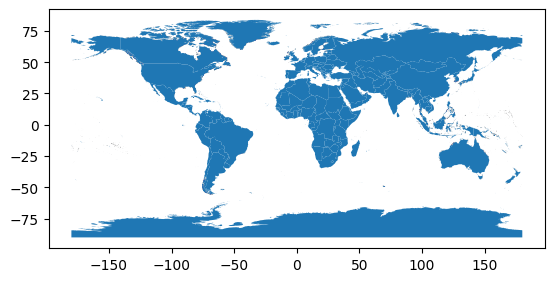

In [37]:
s.plot()

In [38]:
geo_josn = s.to_json()

In [21]:
s_simp  = s.copy()
s_simp['geometry'] = s_simp['geometry'].simplify(0.01)
geo_json_simp = s_simp.to_json()

In [26]:
s_simp.to_file('../geo_json.geojson',driver='GeoJSON')

In [48]:
import pickle
with open('../geo_json.pkl','wb') as f:
    pickle.dump(geo_json_simp,f)


In [50]:
m = folium.Map()
folium.GeoJson(geo_json_simp).add_to(m)
m

In [ ]:
# def download_file_from_google_drive(file_id, filename):
#     request = service.files().get_media(fileId=file_id)
#     fh = io.BytesIO()
#     downloader = MediaIoBaseDownload(fh, request)
#     done = False
#     while not done:
#         status, done = downloader.next_chunk()
#     fh.seek(0)
#     with open(filename, 'wb') as f:
#         f.write(fh.read())
#     return filename

@st.cache_resource
def download_shapefile(file_id_shp, file_id_shx, file_id_dbf, _service):
    with tempfile.NamedTemporaryFile(suffix='.shp', delete=False) as tmp_shp, \
         tempfile.NamedTemporaryFile(suffix='.shx', delete=False) as tmp_shx, \
         tempfile.NamedTemporaryFile(suffix='.dbf', delete=False) as tmp_dbf:

        # Function to download each file part
        def download_file_part(file_id, temp_file):
            request = _service.files().get_media(fileId=file_id)
            fh = io.BytesIO()
            downloader = MediaIoBaseDownload(fh, request)
            done = False
            while not done:
                status, done = downloader.next_chunk()
            fh.seek(0)
            temp_file.write(fh.read())

        download_file_part(file_id_shp, tmp_shp)

    return tmp_shp



@st.cache_data
def load_shape_file(file_id_shp, file_id_shx, file_id_dbf, _service):
    tmp_shp = download_shapefile(file_id_shp, file_id_shx, file_id_dbf, _service)
    with fiona.Env(SHAPE_RESTORE_SHX='YES'):
        gdf = gpd.read_file(tmp_shp.name)
    return gdf

In [9]:
import pickle

In [15]:
with open('../geo_json.pkl','rb') as f:
    geo_json_simp = pickle.load(f)

## raster file

In [36]:
import rasterio
from rasterio.enums import Resampling
from folium import LayerControl
from PIL import Image
import matplotlib.pyplot as plt

In [12]:
def downsample_raster(input_raster, output_raster, downscale_factor):
    with rasterio.open(input_raster) as dataset:
        # Calculate new dimensions
        new_height = dataset.height // downscale_factor
        new_width = dataset.width // downscale_factor

        # Read the data from the original file and downsample
        data = dataset.read(
            out_shape=(dataset.count, new_height, new_width),
            resampling=Resampling.bilinear
        )

        # Adjust the transform and metadata
        transform = dataset.transform * dataset.transform.scale(
            (dataset.width / data.shape[-1]),
            (dataset.height / data.shape[-2])
        )

        new_meta = dataset.meta
        new_meta.update({
            "driver": "GTiff",
            "height": new_height,
            "width": new_width,
            "transform": transform
        })

        # Write the downsampled data to a new file
        with rasterio.open(output_raster, "w", **new_meta) as dest:
            dest.write(data)

# downsample_raster('path_to_your_large_tif_file.tif', 'path_to_your_downsampled_file.tif', downscale_factor=4)

In [13]:
raster_in = '../HILDA_land_conversion_impr2.tif'
raster_out = '../downsampled_HILDA_land_conversion_impr2.tif'
downsample_raster(raster_in,raster_out,downscale_factor=10)

In [68]:
with rasterio.open('../downsampled_HILDA_land_conversion_impr2.tif') as f:
    bounds = f.bounds
    data = f.read(1)
    data_normalized = (data - data.min()) / (data.max() - data.min()) * 255
    image = Image.fromarray(data_normalized.astype('uint8'))
    image.save('../downsampled_HILDA_land_conversion_impr2.png')
print(bounds)

BoundingBox(left=-180.0, bottom=-90.0, right=180.0, top=90.0)


In [27]:
geo_json_simp = gpd.read_file('../geo_json.geojson')
geo_json_simp.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [49]:
with rasterio.open('../maps_file/downsampled_HILDA_land_conversion_impr2.tif') as src:
    # print(src.count) # 1 band(layer)
    band1 = src.read(1)
    nodata = src.nodata
    band1 = np.where(band1 == nodata, np.nan, band1)
    

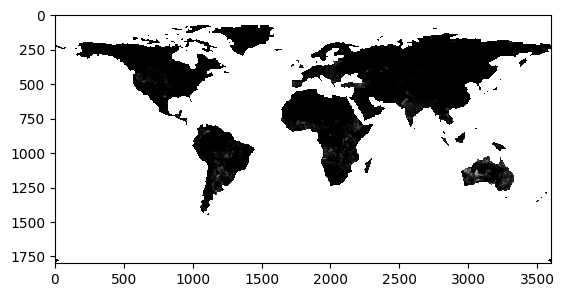

In [53]:
plt.imshow(band1, cmap='gray')

In [52]:
# plt.hist(band1.ravel(), bins=50, range=[band1.min(), band1.max()])
# plt.title('Histogram of Raster Values')
# plt.show()

In [58]:
band1_nona = band1[np.isnan(band1)==False]
plt.hist(band1_nona.ravel(), bins=50, range=[band1_nona.min(), band1_nona.max()])
plt.title('Histogram of Raster Values')
plt.show()

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [69]:
# Create the map object
m = folium.Map()

# Your GeoJSON layer (assuming you have this set up)
geojson_layer = folium.GeoJson(geo_json_simp, name='GeoJSON Layer').add_to(m)

min_lon, min_lat, max_lon, max_lat = bounds.left, bounds.bottom, bounds.right, bounds.top

# Add the raster layer using ImageOverlay
image_overlay = folium.raster_layers.ImageOverlay(
    name='Raster Layer',
    image='../downsampled_HILDA_land_conversion_impr2.png',  # Local path to the raster file
    bounds=[[min_lat, min_lon], [max_lat, max_lon]],
    opacity=0.7,
    interactive=True,
    cross_origin=False
)
image_overlay.add_to(m)

# Add layer control
LayerControl().add_to(m)